# EDA

Dataset from https://www.kaggle.com/datasets/anshankul/ibm-amlsim-example-dataset?select=transactions.csv

# Extract data and analyze

In [1]:
# Extract
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

accounts_df = pd.read_csv('data/accounts.csv')
alerts_df = pd.read_csv('data/alerts.csv')

# Read zip file
import zipfile
import os

with zipfile.ZipFile('data/transactions.csv.zip', 'r') as zip_ref:
    zip_ref.extractall('data')

transaction_df = pd.read_csv('data/transactions.csv')

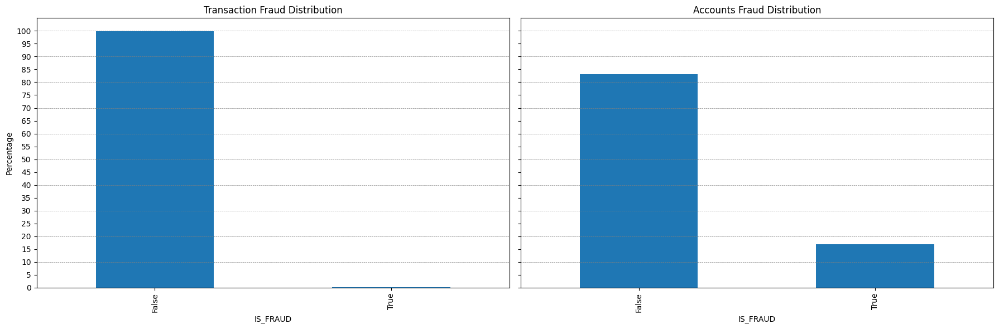

,TX_ID,SENDER_ACCOUNT_ID,RECEIVER_ACCOUNT_ID,TX_TYPE,TX_AMOUNT,TIMESTAMP,IS_FRAUD,ALERT_ID
0,1,6456,9069,TRANSFER,465.05,0,False,-1
1,2,7516,9543,TRANSFER,564.64,0,False,-1
2,3,2445,9356,TRANSFER,598.94,0,False,-1
3,4,2576,4617,TRANSFER,466.07,0,False,-1
4,5,3524,1773,TRANSFER,405.63,0,False,-1


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming transaction_df, accounts_df, and alerts_df are your DataFrames
distributions = (
    transaction_df.groupby('IS_FRAUD').size(),
    accounts_df.groupby('IS_FRAUD').size()
)

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(18, 6), sharey=True)

# Titles for each subplot
titles = ['Transaction Fraud Distribution', 'Accounts Fraud Distribution']

# Plot each distribution in a separate subplot
for ax, df, title in zip(axes, distributions, titles):
    percentage_by_group = (df / df.sum()) * 100
    percentage_by_group.plot(kind='bar', ax=ax)
    ax.set_xlabel('IS_FRAUD')
    ax.set_ylabel('Percentage')
    ax.set_title(title)
    ax.set_yticks(range(0, 101, 5))

    # Add horizontal lines at specified y-values
    for y in range(0, 101, 10):
        ax.axhline(y=y, color='gray', linestyle='--', linewidth=0.5)

# Adjust layout
plt.tight_layout()
plt.show()

# Build graph

Build graph using "networkX"

In [4]:
# Build graph from the data
import networkx as nx
from sklearn.model_selection import train_test_split
from sklearn.utils import resample

number_of_transactions = len(transaction_df)
G = nx.DiGraph()

# Assuming df is your DataFrame and 'is_fraud' is the label column
df_majority = transaction_df[transaction_df.IS_FRAUD == 0]
df_minority = transaction_df[transaction_df.IS_FRAUD == 1]

# Upsample minority class
df_majority_downsampled = resample(df_majority, 
                                 replace=True,     # sample with replacement
                                 n_samples=int(len(df_minority) * 8),    # to match majority class
                                 random_state=123) # reproducible results

# Combine majority class with upsampled minority class
df = pd.concat([df_minority, df_majority_downsampled])

# Display new class counts
print(df.IS_FRAUD.value_counts())


# df = df, _ = train_test_split(df, test_size=0.1, stratify=df['IS_FRAUD'], random_state=42)
aggregation = {}


df.IS_FRAUD.value_counts()

IS_FRAUD
False    13752
True      1719
Name: count, dtype: int64


IS_FRAUD
False    13752
True      1719
Name: count, dtype: int64

In [5]:
for it in df.groupby(['SENDER_ACCOUNT_ID', 'RECEIVER_ACCOUNT_ID']).count().itertuples():
    sender_acc_id = it[0][0]
    receiver_acc_id = it[0][1]

    

In [6]:

count = 0
# for t in df.itertuples():
grouped_by_sender_receiver_df = df.groupby(['SENDER_ACCOUNT_ID', 'RECEIVER_ACCOUNT_ID']).count()
for it in grouped_by_sender_receiver_df.itertuples():
    sender_id = it[0][0]
    receiver_id = it[0][1]
    # sender_id = t.SENDER_ACCOUNT_ID
    # receiver_id = t.RECEIVER_ACCOUNT_ID

    sender_acc = accounts_df[accounts_df.ACCOUNT_ID == sender_id].iloc[0]
    sender = {
        "id": sender_id,
        "type": "account",
        "country": sender_acc.COUNTRY,
        "customer_id": sender_acc.CUSTOMER_ID,
        "is_fraud": bool(sender_acc.IS_FRAUD),
    }

    receiver_acc = accounts_df[accounts_df.ACCOUNT_ID == receiver_id].iloc[0]
    receiver = {
        "id": receiver_id,
        "type": "account",
        "country": receiver_acc.COUNTRY,
        "customer_id": receiver_acc.CUSTOMER_ID,
        "is_fraud": bool(receiver_acc.IS_FRAUD),
    }

    pair_key = f"{sender_id}-{receiver_id}"

    if pair_key not in aggregation:
        pair_transactions = transaction_df.query("SENDER_ACCOUNT_ID == @sender_id and RECEIVER_ACCOUNT_ID == @receiver_id")

        # Proportion of fraud transactions
        fraud_proportion = len(pair_transactions.query("IS_FRAUD == True")) / len(pair_transactions)


        aggregation[pair_key] = {
            "total_transactions": len(pair_transactions),
            "total_amount": pair_transactions["TX_AMOUNT"].sum(),
            "min_amount": pair_transactions["TX_AMOUNT"].min(),
            "max_amount": pair_transactions["TX_AMOUNT"].max(),
            "mean_amount": pair_transactions["TX_AMOUNT"].mean(),
            "total_transactions": len(pair_transactions),
            "fraud_proportion": fraud_proportion,
        }

    

    tx_edge_attrs = {
        **aggregation[pair_key]
    }

    # account_ownership_attrs = {"type": "owns"}

    # Accounts
    G.add_node(sender_id, **sender)
    G.add_node(receiver_id, **receiver)

    # Customers
    # G.add_node(sender["customer_id"], **{"type": "customer", "is_fraud": sender["is_fraud"]})
    # G.add_node(receiver["customer_id"], **{"type": "customer", "is_fraud": receiver["is_fraud"]})

    # Transactions
    G.add_edge(sender_id, receiver_id, **tx_edge_attrs)

    # Customer to account
    # G.add_edge(sender["customer_id"], sender_id, **account_ownership_attrs)
    # G.add_edge(receiver["customer_id"], receiver_id, **account_ownership_attrs)

    # Print progress
    count += 1
    if count % 1000 == 0:
        print(f"{count}/{len(grouped_by_sender_receiver_df)} processed")
    

1000/12434 processed
2000/12434 processed
3000/12434 processed
4000/12434 processed
5000/12434 processed
6000/12434 processed
7000/12434 processed
8000/12434 processed
9000/12434 processed
10000/12434 processed
11000/12434 processed
12000/12434 processed


In [9]:
for node, attrs in G.nodes(data=True):
    print(node, attrs)

3 {'id': 3, 'type': 'account', 'country': 'US', 'customer_id': 'C_3', 'is_fraud': False}
9556 {'id': 9556, 'type': 'account', 'country': 'US', 'customer_id': 'C_9556', 'is_fraud': False}
8 {'id': 8, 'type': 'account', 'country': 'US', 'customer_id': 'C_8', 'is_fraud': False}
5490 {'id': 5490, 'type': 'account', 'country': 'US', 'customer_id': 'C_5490', 'is_fraud': False}
14 {'id': 14, 'type': 'account', 'country': 'US', 'customer_id': 'C_14', 'is_fraud': False}
7000 {'id': 7000, 'type': 'account', 'country': 'US', 'customer_id': 'C_7000', 'is_fraud': False}
15 {'id': 15, 'type': 'account', 'country': 'US', 'customer_id': 'C_15', 'is_fraud': False}
2488 {'id': 2488, 'type': 'account', 'country': 'US', 'customer_id': 'C_2488', 'is_fraud': False}
30 {'id': 30, 'type': 'account', 'country': 'US', 'customer_id': 'C_30', 'is_fraud': False}
3450 {'id': 3450, 'type': 'account', 'country': 'US', 'customer_id': 'C_3450', 'is_fraud': False}
31 {'id': 31, 'type': 'account', 'country': 'US', 'custo

# Build graph in a database

Instead of dealing with the graph just using "networkX", this step will go further and will create a graph databse that supports Cypher queries.

In [11]:
print(len(set([attrs["customer_id"] for node, attrs in G.nodes(data=True)])))


# Export to graphml
nx.write_graphml(G, "data/graph.graphml")

8292


# Plot the graph
To visually "see" the graph.

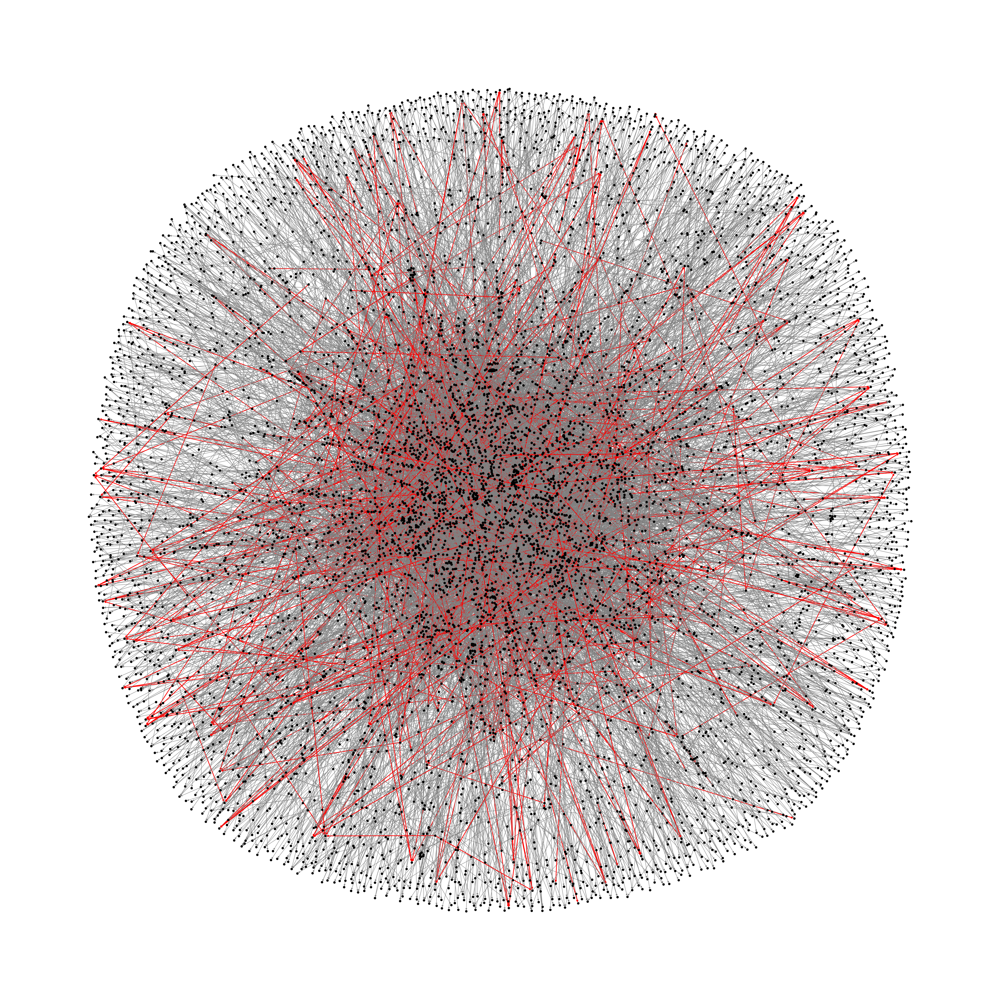

In [48]:
#  Render the graph using matplotlib
plt.figure(figsize=(40, 40))
pos = nx.shell_layout(G)

edge_colors = ["red" if attrs.get("fraud_proportion") > 0 else "grey" for a, b, attrs in G.edges(data=True)]

# Nomralization of edge sizes
edges_sizes = [2 if attrs["fraud_proportion"] > 0 else 1.0  for a, b, attrs in G.edges(data=True)]

# nx.draw_networkx_edges(G, pos, edge_color=edge_colors)
# nx.draw_networkx_nodes(G, pos, node_size=5, node_color="black")

nx.draw_spring(G, node_size=35, node_color="black", edge_color=edge_colors, width=edges_sizes)
plt.show()
